In [1]:
import numpy as np
import skimage as sk
import skimage.io as skio
import scipy
import scipy.spatial as sp
import matplotlib
from matplotlib import pyplot as plt
import json
from importlib import reload
import itertools
# local
import utils
reload(utils)
from utils import *

# Part 1
I used https://cal-cs180.github.io/fa23/hw/proj3/tool.html to label correspondences.

In [2]:
with open('data/pts.json', 'r') as file:
    correspondences = json.load(file)

In [3]:
me_im = sk.img_as_float(skio.imread('data/me.jpg'))
kamala_im = sk.img_as_float(skio.imread('data/kamala.jpg'))

me_pts = np.asarray(correspondences['im1Points'])
kamala_pts = np.asarray(correspondences['im2Points'])

corner_pts = list(itertools.product([0, me_im.shape[1]], [0, me_im.shape[0]]))

me_pts = np.vstack([me_pts, corner_pts])
kamala_pts = np.vstack([kamala_pts, corner_pts])

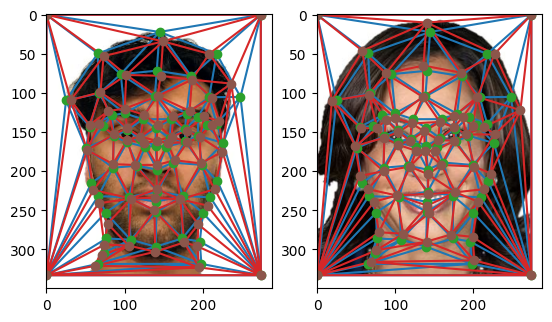

In [4]:
midway_pts = (me_pts + kamala_pts) / 2
midway_delaunay = sp.Delaunay(midway_pts)

fig, (ax1, ax2) = plt.subplots(1, 2)

ax1.imshow(me_im)
plot_delaunay(ax1, midway_pts)
plot_delaunay(ax1, me_pts)

ax2.imshow(kamala_im)
plot_delaunay(ax2, midway_pts)
plot_delaunay(ax2, kamala_pts)

plt.show()

# Part 2

In [5]:
midway_triangles = midway_pts[midway_delaunay.simplices]
me_triangles = me_pts[midway_delaunay.simplices]
kamala_triangles = kamala_pts[midway_delaunay.simplices]

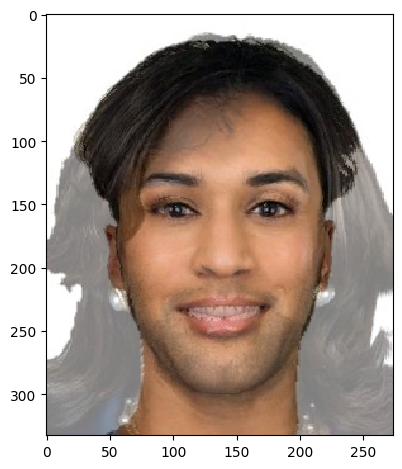

In [6]:
me_midway = np.zeros(me_im.shape)
kamala_midway = np.zeros(kamala_im.shape)

for (tri1, tri2) in zip(midway_triangles, me_triangles):
    A_inv = compute_affine(tri1, tri2)
    apply_inverse_affine_transformation(A_inv, me_im, me_midway, sk.draw.polygon(tri1[:, 0], tri1[:, 1]))

for (tri1, tri2) in zip(midway_triangles, kamala_triangles):
    A_inv = compute_affine(tri1, tri2)
    apply_inverse_affine_transformation(A_inv, kamala_im, kamala_midway, sk.draw.polygon(tri1[:, 0], tri1[:, 1]))
    
skio.imshow((me_midway + kamala_midway) / 2)
skio.show()

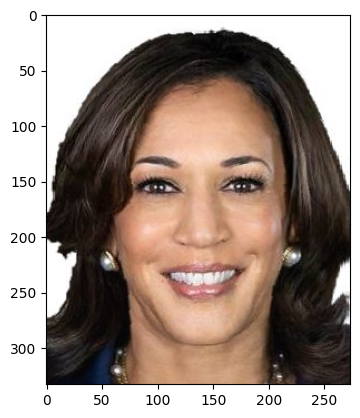

In [7]:
import matplotlib.animation as animation

fig, ax = plt.subplots()
plt.rcParams["animation.html"] = "jshtml"
plt.ioff()

FRAMES=90

def animate(i):
    frac = i / FRAMES
    ax.imshow(morph(me_im, kamala_im, me_pts, kamala_pts, midway_delaunay, frac, frac))

animation.FuncAnimation(fig, animate, frames=FRAMES)

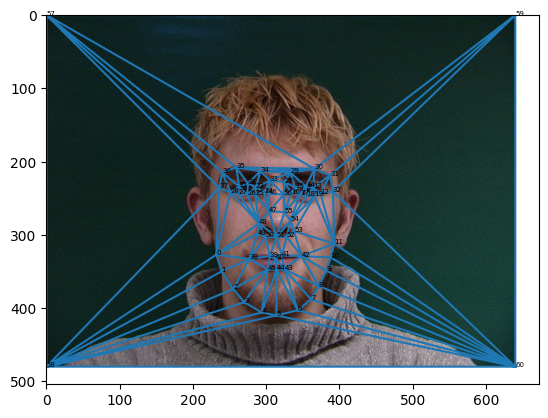

In [8]:
sample_im = sk.img_as_float(skio.imread('imm_face_db/01-1m.jpg'))
sample_pts, sample_tri = parse_asf(sample_im, 'imm_face_db/01-1m.asf')

fig, ax = plt.subplots()
ax.imshow(sample_im)
ax.triplot(sample_pts[:,0], sample_pts[:,1], sample_tri)
for i, (x, y) in enumerate(sample_pts):
    ax.text(x, y, i, fontsize=5)

plt.show()

In [9]:
import os.path

all_pts = []

for i in range(1, 41):
    jpg = f'imm_face_db/{i}-1m.jpg'
    asf = f'imm_face_db/{i}-1m.asf'
    if os.path.isfile(jpg):
        im = sk.img_as_float(skio.imread(jpg))
        pts, _ = parse_asf(im, asf)
        all_pts += [pts]

avg_male_pts = np.sum(all_pts, axis=0) / len(all_pts)

In [10]:
before_and_after = []

for i in range(1, 41):
    if i < 10: i = f'0{i}'
    for s in ('m', 'f'):
        jpg = f'imm_face_db/{i}-1{s}.jpg'
        asf = f'imm_face_db/{i}-1{s}.asf'
        if os.path.isfile(jpg):
            im = sk.img_as_float(skio.imread(jpg))
            pts, _ = parse_asf(im, asf)
            warped = warp(im, pts, avg_male_pts, sp.Delaunay(avg_male_pts))
            before_and_after.append((jpg, im, warped))

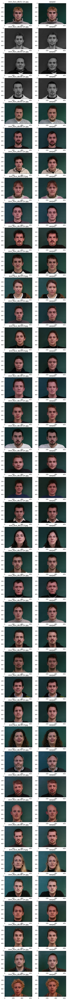

In [11]:
fig, rows = plt.subplots(len(before_and_after), 2, figsize=(8, 128))
for (ax1, ax2), (name, im, warped_im) in zip(rows, before_and_after):
    ax1.imshow(im)
    ax1.set_title(name)
    ax2.imshow(warped_im)
    ax2.set_title('warped')

plt.show()

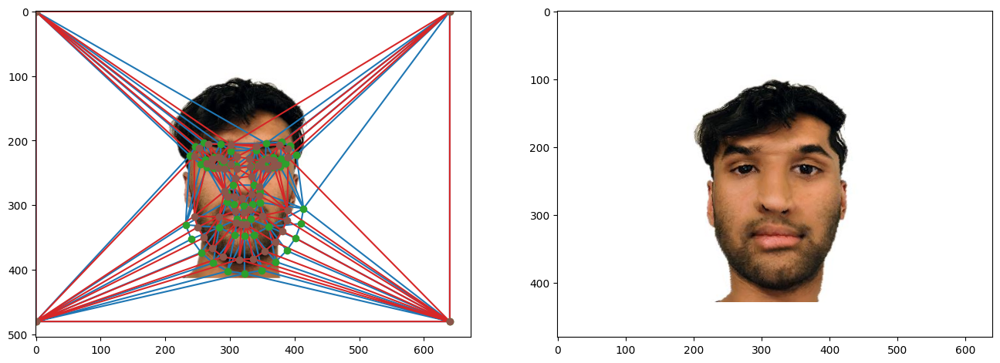

In [12]:
with open('data/ordered_pts.json', 'r') as file:
    me_ordered = json.load(file)

me_ordered_pts = np.asarray(me_ordered['im1Points'])

X_OFFSET, Y_OFFSET = 80, 180

# Center the image and the points on sample_im.shape.
me_ordered_pts = me_ordered_pts + np.vstack([[Y_OFFSET] * len(me_ordered_pts), [X_OFFSET] * len(me_ordered_pts)]).T
corner_pts = list(itertools.product([0, sample_im.shape[1]], [0, sample_im.shape[0]]))
me_ordered_pts = np.vstack([me_ordered_pts, corner_pts])

me_corrected_im = np.ones(sample_im.shape)
me_corrected_im[X_OFFSET:X_OFFSET + me_im.shape[0], Y_OFFSET:Y_OFFSET + me_im.shape[1], :] = me_im
warped = warp(me_corrected_im, me_ordered_pts, avg_male_pts, sp.Delaunay(avg_male_pts))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 16))
ax1.imshow(me_corrected_im)
plot_delaunay(ax1, avg_male_pts)
plot_delaunay(ax1, me_ordered_pts)

ax2.imshow(warped)
plt.show()

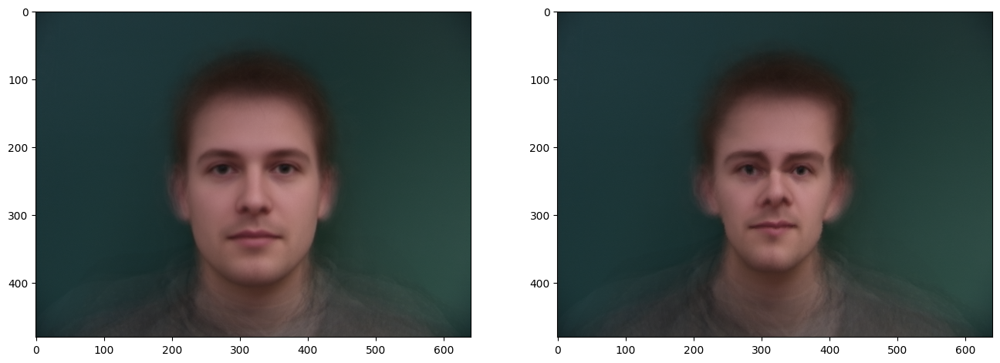

In [13]:
avg_im = np.zeros(sample_im.shape)
for _, _, warped in before_and_after:
    avg_im = avg_im + warped

avg_im = avg_im / len(before_and_after)
warped_avg_im = warp(avg_im, avg_male_pts, me_ordered_pts, sp.Delaunay(me_ordered_pts))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 16))
ax1.imshow(avg_im)
ax2.imshow(warped_avg_im)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.40955882352941175..0.9994117647058827].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8794117647058823..1.3325490196078436].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8191176470588235..1.9988235294117653].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.698529411764706..3.331372549019609].


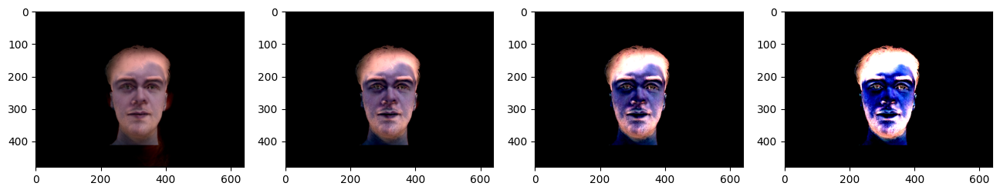

In [32]:
extraction = lambda alpha: alpha*warped_avg_im + (1-alpha)*me_corrected_im

fig, axs = plt.subplots(1, 4, figsize=(16, 16))
for ax, alpha in zip(axs, [1.2, 1.5, 3, 5]):
    ax.imshow(extraction(alpha))

plt.show()